In [12]:
# %%python -m ensurepip --upgrade
# %pip uninstall datasets
# %pip install "datasets<3.0"
# %pip install xgboost
# 




   ---------------------------------------- 0.0/150.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/150.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/150.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/150.0 MB ? eta -:--:--
   ---------------------------------------- 0.3/150.0 MB ? eta -:--:--
   ---------------------------------------- 0.5/150.0 MB 923.5 kB/s eta 0:02:42
   ---------------------------------------- 0.5/150.0 MB 923.5 kB/s eta 0:02:42
   ---------------------------------------- 0.8/150.0 MB 858.5 kB/s eta 0:02:54
   ---------------------------------------- 0.8/150.0 MB 858.5 kB/s eta 0:02:54
   ---------------------------------------- 1.0/150.0 MB 750.1 kB/s eta 0:03:19
   ---------------------------------------- 1.0/150.0 MB 750.1 kB/s eta 0:03:19
   ---------------------------------------- 1.3/150.0 MB 763.5 kB/s eta 0:03:15
   ---------------------------------------- 1.6/150.0 MB 788.4 kB/s eta 0:03:09
   --


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
from datasets import load_dataset # type: ignore

# Wczytanie tylko podzbioru 'UHH'
dataset = load_dataset("DBD-research-group/BirdSet", name="UHH", trust_remote_code=True)


In [2]:
from collections import Counter

# Załaduj zbiór
train_data = dataset["train"]

# Pobierz etykiety tekstowe na podstawie ebird_code
label_names = train_data.features["ebird_code"].names

# Zlicz wystąpienia każdego kodu
species_counts = Counter(example["ebird_code"] for example in train_data)

# Zamień na tekstowe nazwy gatunków
top_10_species = [
    (label_names[code], count)
    for code, count in species_counts.most_common(15)
]

# Wyświetl
print("10 najczęstszych gatunków:")
for species, count in top_10_species:
    print(f"{species}: {count} przykładów")

10 najczęstszych gatunków:
skylar: 1456 przykładów
norcar: 692 przykładów
houfin: 368 przykładów
comwax: 281 przykładów
calqua: 147 przykładów
wiltur: 92 przykładów
yefcan: 81 przykładów
chukar: 72 przykładów
warwhe1: 71 przykładów
blkfra: 65 przykładów
jabwar: 63 przykładów
apapan: 53 przykładów
iiwi: 36 przykładów
kalphe: 22 przykładów
hawama: 22 przykładów


In [16]:
signal, sr = librosa.load(dataset['train'][0]['filepath'], sr=None)
signal.shape

(3275136,)

In [17]:
sr

32000

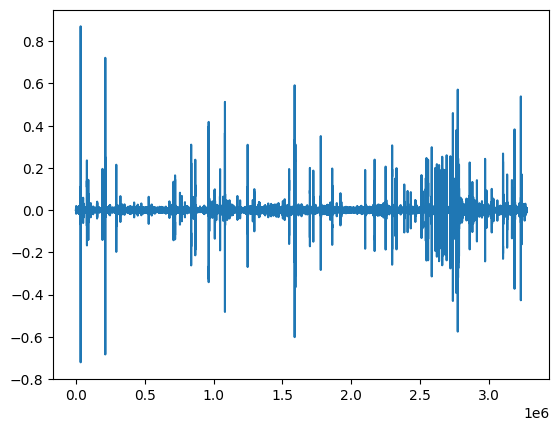

In [18]:
plt.plot(signal)
plt.show()

In [ ]:
import IPython


def play_first_audio(filepath):
    signal, sr = librosa.load(filepath, sr=None)
    print("▶️ Odtwarzanie pierwszego dźwięku:")
    return IPython.display.Audio(signal, rate=sr)

play_first_audio(dataset['train'][0]['filepath'])

▶️ Odtwarzanie pierwszego dźwięku:


In [29]:
def butter_highpass(cutoff, fs, filter_type, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype=filter_type, analog=False)
    return b, a

def butter_filter(data, cutoff, fs, filter_type='high', order=5):
    b, a = butter_highpass(cutoff, fs, filter_type, order=order)
    return filtfilt(b, a, data)

def wavelet_denoise(audio_signal, wavelet='db1'):
    coeffs = pywt.wavedec(audio_signal, wavelet)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(audio_signal)))
    denoised_coeffs = [pywt.threshold(c, value=threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet)

def fft_bandpass(signal, sr, freq_min=300, freq_max=3000):
    n = len(signal)
    fft_vals = fft(signal)
    fft_freq = np.fft.fftfreq(n, d=1/sr)
    filtered_fft_vals = np.copy(fft_vals)
    filtered_fft_vals[(fft_freq <= freq_min) | (fft_freq >= freq_max)] = 0
    return np.real(ifft(filtered_fft_vals))

# === FILTRACJA ===
def apply_filter(signal, sr, filter_type):
    if filter_type == 'savgol':
        return savgol_filter(signal, 101, 3)
    elif filter_type == 'butter':
        filtered = butter_filter(signal, 200, sr)
        analytic_signal = np.abs(hilbert(filtered))
        return butter_filter(analytic_signal, 2000, sr, filter_type='low')
    elif filter_type == 'fft':
        return fft_bandpass(signal, sr)
    elif filter_type == 'wavelet':
        return wavelet_denoise(signal)
    return signal

C:\Users\NQW483\AppData\Roaming\Python\Python313\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128266 (\N{SPEAKER WITH THREE SOUND WAVES}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


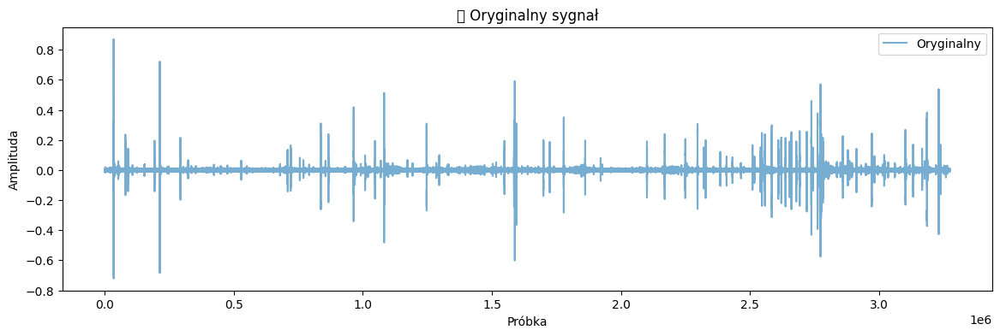

C:\Users\NQW483\AppData\Roaming\Python\Python313\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128201 (\N{CHART WITH DOWNWARDS TREND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


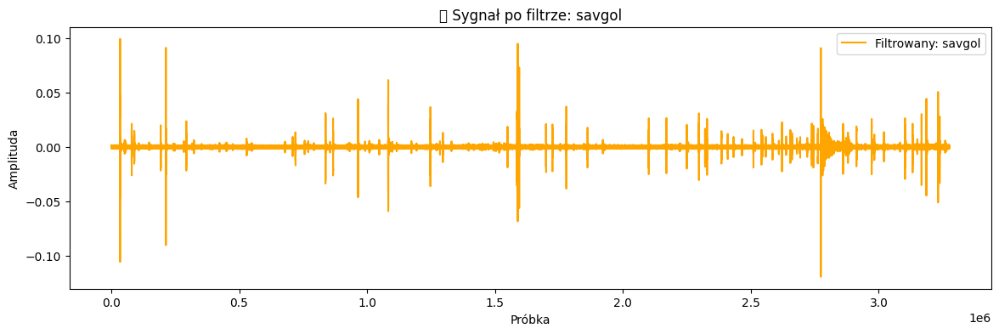

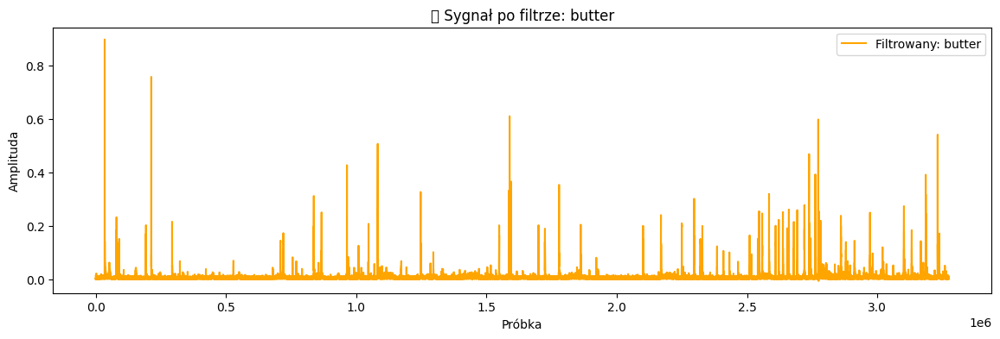

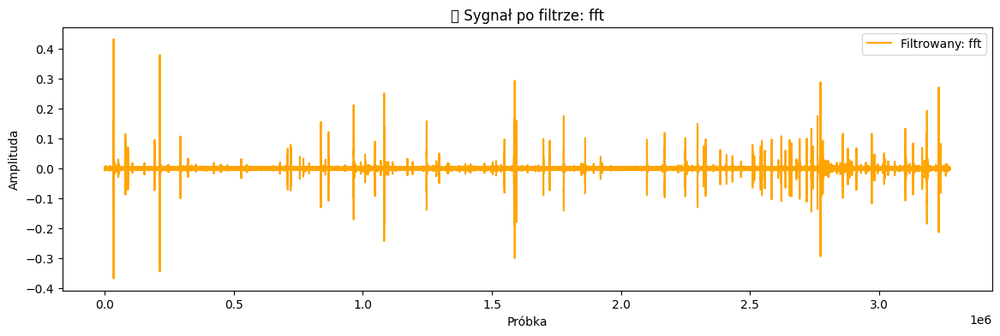

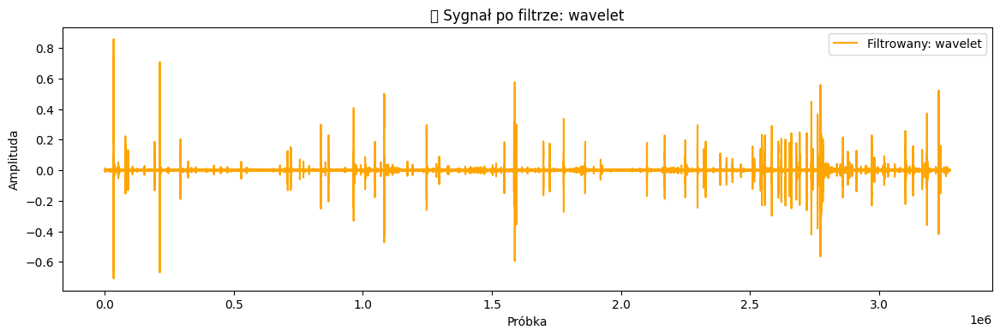

In [38]:
import matplotlib.pyplot as plt
import librosa
import numpy as np
from IPython.display import display, Audio

FILTER_TYPES = ['savgol', 'butter', 'fft', 'wavelet']

def compare_filters(filepath):
    signal, sr = librosa.load(filepath, sr=None)

    plt.figure(figsize=(14, 4))
    plt.plot(signal, alpha=0.6, label='Oryginalny')
    plt.title("🔊 Oryginalny sygnał")
    plt.xlabel("Próbka")
    plt.ylabel("Amplituda")
    plt.legend()
    plt.show()
    display(Audio(signal, rate=sr))
    
    for filter_type in FILTER_TYPES:
        try:
            filtered = apply_filter(signal, sr, filter_type)
            plt.figure(figsize=(14, 4))
            plt.plot(filtered, label=f'Filtrowany: {filter_type}', color='orange')
            plt.title(f"📉 Sygnał po filtrze: {filter_type}")
            plt.xlabel("Próbka")
            plt.ylabel("Amplituda")
            plt.legend()
            plt.show()
            display(Audio(filtered, rate=sr))

        except Exception as e:
            print(f"❌ Błąd przy filtrze '{filter_type}': {e}")

compare_filters(dataset['train'][0]['filepath'])

In [ ]:
#Savgol chyba najlepsze

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, hilbert, savgol_filter
from scipy.fft import fft, ifft
import speechpy
import librosa
from collections import Counter
from IPython.display import Audio, display
import pywt
from scipy import signal as sg
from datasets import load_dataset

# === PARAMETRY ===
SELECTED_SPECIES = ["houfin", "comwax", "calqua", "wiltur"]
FILTER_TYPE = 'butter'  # 'savgol', 'butter', 'fft', 'wavelet'
FEATURE_TYPE = 'mfcc'   # 'mfcc', 'mfe', 'wavelet', 'lpc', 'pca'
RESAMPLE_RATE = 16000
EXPORT_CSV_PATH = "filtered_features.csv"

# === FUNKCJE FILTRUJĄCE ===
def butter_highpass(cutoff, fs, filter_type, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype=filter_type, analog=False)
    return b, a

def butter_filter(data, cutoff, fs, filter_type='high', order=5):
    b, a = butter_highpass(cutoff, fs, filter_type, order=order)
    return filtfilt(b, a, data)

def wavelet_denoise(audio_signal, wavelet='db1'):
    coeffs = pywt.wavedec(audio_signal, wavelet)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(audio_signal)))
    denoised_coeffs = [pywt.threshold(c, value=threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet)

def fft_bandpass(signal, sr, freq_min=300, freq_max=3000):
    n = len(signal)
    fft_vals = fft(signal)
    fft_freq = np.fft.fftfreq(n, d=1/sr)
    filtered_fft_vals = np.copy(fft_vals)
    filtered_fft_vals[(fft_freq <= freq_min) | (fft_freq >= freq_max)] = 0
    return np.real(ifft(filtered_fft_vals))

# === FILTRACJA ===
def apply_filter(signal, sr, filter_type):
    if filter_type == 'savgol':
        return savgol_filter(signal, 101, 3)
    elif filter_type == 'butter':
        filtered = butter_filter(signal, 200, sr)
        analytic_signal = np.abs(hilbert(filtered))
        return butter_filter(analytic_signal, 2000, sr, filter_type='low')
    elif filter_type == 'fft':
        return fft_bandpass(signal, sr)
    elif filter_type == 'wavelet':
        return wavelet_denoise(signal)
    return signal

# === EKSTRAKCJA CECH ===
def extract_features(signal, sr, feature_type):
    if feature_type == 'mfcc':
        mfccs = librosa.feature.mfcc(y=signal, sr=sr, n_mfcc=13)
        return mfccs.T
    elif feature_type == 'mfe':
        features = speechpy.feature.lmfe(signal, sampling_frequency=sr, frame_length=0.025,
                                         frame_stride=0.01, num_filters=40, fft_length=512)
        return speechpy.processing.cmvn(features)
    elif feature_type == 'wavelet':
        coeffs = pywt.wavedec(signal, 'db1')
        return np.hstack([np.mean(c) for c in coeffs])
    elif feature_type == 'lpc':
        return librosa.lpc(signal, order=13)
    elif feature_type == 'pca':
        from sklearn.decomposition import PCA
        pca = PCA(n_components=5)
        return pca.fit_transform(signal.reshape(-1, 1)).flatten()
    return signal

# === SEGMENTACJA ===
def segment_signal(audio_signal, start=2500, end=5000, window_size=250, distance=200):
    signal_part = audio_signal[start:end]
    peaks, _ = sg.find_peaks(signal_part, height=None, distance=distance)
    segments = []
    for peak in peaks:
        seg_start = max(0, peak - window_size // 2)
        seg_end = min(len(signal_part), peak + window_size // 2)
        segment = signal_part[seg_start:seg_end]
        if len(segment) == window_size:
            segments.append(segment)
    return segments

# === EKSPORT DANYCH DO CSV ===
def export_features_to_csv(filtered_data):
    rows = []
    label_names = filtered_data.features["ebird_code"].names
    for example in filtered_data:
        filepath = example['filepath']
        label = label_names[example['ebird_code']]
        filename = os.path.basename(filepath)
        try:
            signal, sr = librosa.load(filepath, sr=None)
            if RESAMPLE_RATE is not None:
                signal = librosa.resample(signal, orig_sr=sr, target_sr=RESAMPLE_RATE)
                sr = RESAMPLE_RATE

            filtered_signal = apply_filter(signal, sr, FILTER_TYPE)
            segments = segment_signal(filtered_signal)
            if not segments:
                print(f"⚠️ Brak segmentów: {filepath}")
                continue

            for i, segment in enumerate(segments):
                feats = extract_features(segment, sr, FEATURE_TYPE)
                flat = feats.flatten() if feats.ndim > 1 else feats

                row = dict(zip([f"f{i}" for i in range(len(flat))], flat))
                row['Diagnosis'] = label
                row['Segment'] = i
                row['SourceFile'] = filename
                rows.append(row)

        except Exception as e:
            print(f"❌ Błąd przetwarzania {filepath}: {e}")

    df = pd.DataFrame(rows)
    df.to_csv(EXPORT_CSV_PATH, index=False)
    print(f"✅ Zapisano {len(df)} segmentów do: {EXPORT_CSV_PATH}")

# === ANALIZA GATUNKÓW ===
def list_top_species(dataset, top_n=15):
    train_data = dataset["train"]
    label_names = train_data.features["ebird_code"].names
    species_counts = Counter(example["ebird_code"] for example in train_data)
    top_species = [(label_names[code], count) for code, count in species_counts.most_common(top_n)]
    print(f"{top_n} najczęstszych gatunków:")
    for species, count in top_species:
        print(f"{species}: {count} przykładów")

# === FILTROWANIE WYBRANYCH GATUNKÓW ===
def filter_selected_species(dataset):
    train_data = dataset["train"]
    label_names = train_data.features["ebird_code"].names
    selected_codes = [label_names.index(species) for species in SELECTED_SPECIES if species in label_names]
    filtered = train_data.filter(lambda example: example["ebird_code"] in selected_codes)
    print(f"Znaleziono {len(filtered)} przykładów dla wybranych gatunków.")
    return filtered

# === URUCHOMIENIE ===

filtered_data = filter_selected_species(dataset)
export_features_to_csv(filtered_data)

Znaleziono 888 przykładów dla wybranych gatunków.
1


c:\Users\NQW483\AppData\Local\Programs\Python\Python313\Lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=250
  warnings.warn(


9
8
9
8
9
9
9
10
8
8
10
8
8
7
9
11
8
8
9
7
⚠️ Brak segmentów: C:/Users/NQW483/.cache/huggingface/datasets/downloads\extracted\958ecbeb593f5b0332d44210947b875a2af142d51de694235bc5f8aab5e3ffbf\XC153455.ogg
8
9
9
2
9
9
8
8
8
7
8
7
8
9
7
8
7
10
8
8
7
8
9
9
8
9
7
10
9
8
8
8
9
8
8
7
8
9
9
10
8
7
8
8
9
7
10
7
8
8
8
8
8
8
7
8
9
8
10
5
7
9
9
8
8
8
8
9
8
8
8
9
7
9
8
8
10
8
8
9
8
8
9
10
8
8
8
8
9
8
7
9
8
8
8
9
8
8
9
8
8
8
7
9
9
8
6
7
7
7
8
8
8
8
10
7
9
9
9
8
8
7
9
7
9
9
8
9
9
8
8
9
8
9
8
8
9
9
8
8
8
7
9
9
8
8
8
7
9
7
6
9
8
8
8
7
8
8
8
9
7
8
9
8
10
7
8
7
8
7
9
9
9
8
8
8
9
8
9
9
8
9
8
9
7
9
8
9
8
9
8
8
8
9
7
9
8
8
9
9
8
8
9
8
8
8
9
9
8
8
8
8
6
8
8
9
8
7
8
8
8
9
8
8
9
8
8
9
7
9
9
10
9
10
8
7
9
9
8
8
9
8
8
7
9
8
8
9
8
8
8
8
9
8
9
9
7
8
9
7
8
9
8
9
9
8
8
9
9
7
9
10
8
7
9
9
8
8
8
8
7
8
7
8
9
7
8
9
9
8
9
9
8
9
7
9
8
8
8
8
9
7
9
9
7
8
7
9
8
8
8
8
7
9
8
8
8
8
9
8
8
10
9
8
8
9
8
8
8
8
9
8
9
8
9
8
8
8
8
8
8
7
9
9
9
8
9
8
9
9
9
8
8
10
8
9
7
9
9
8
8
8
7
8
8
8
8
8
9
8
7
7
8
9
9
8
10
9
8
8
9
9
8
8
7
9
8
9
8
8
8